In [5]:
import numpy as np
import matplotlib.pyplot as plt
from psiam_delay_paper_utils import rho_E_t_fn
from scipy.integrate import quad
from scipy.special import  erfcx
from tqdm import tqdm
from joblib import Parallel, delayed

# See DV over time

In [94]:
def simulate_ddm(sigma_by_mu, v, a, dt, T):
    sigma = v*sigma_by_mu
    t_max = int(T/dt)
    
    dB = dt**0.5 
    DV_arr = np.full((t_max), np.nan)

    DV = 0
    DV_arr[0] = DV
    for t in range(1,t_max):
        DV += v*dt + sigma*np.random.normal(0, dB)
        DV_arr[t] = DV
        # if DV >= a/2:
        #     break
        # elif DV <= -a/2:
        #     break
    
    # if DV < a/2 and DV > -a/2:
    #     print(f'DV value is {DV}')
    #     raise ValueError('Simulation failed')
    
    return  DV_arr

In [95]:
a = 100
dt = 1e-4
T = 3
N_sim = 10000
t_max = int(T/dt)
sigma_by_mu = 0.05

In [96]:
v1 = 2

sim_results_v1 = np.zeros((N_sim, t_max))


for i in tqdm(range(N_sim)):
    result = simulate_ddm(sigma_by_mu, v1, a, dt, T)
    sim_results_v1[i,:] = result

100%|██████████| 10000/10000 [04:37<00:00, 36.05it/s]


In [115]:
v2 = 1

sim_results_v2 = np.zeros((N_sim, t_max))
sigma_by_mu_2 = ((v1/v2)*(sigma_by_mu**2))**0.5

for i in tqdm(range(N_sim)):
    result = simulate_ddm(sigma_by_mu_2, v2, a, dt, T)
    sim_results_v2[i,:] = result

  0%|          | 0/10000 [00:00<?, ?it/s]

100%|██████████| 10000/10000 [04:35<00:00, 36.32it/s]


In [116]:
def pdf(x,v,t, sigma_by_mu):
    var = ((sigma_by_mu*v)**2)*t
    return (1/(2*np.pi*var)**0.5) * np.exp(-((x - v*t)**2)/(2*(var)))

In [117]:
x_pts = np.linspace(1, 3, 1000)

t_fast = 1
t_fast_idx = int(t_fast/dt)
pdf_1 = [pdf(x, v1, t_fast, sigma_by_mu) for x in x_pts]

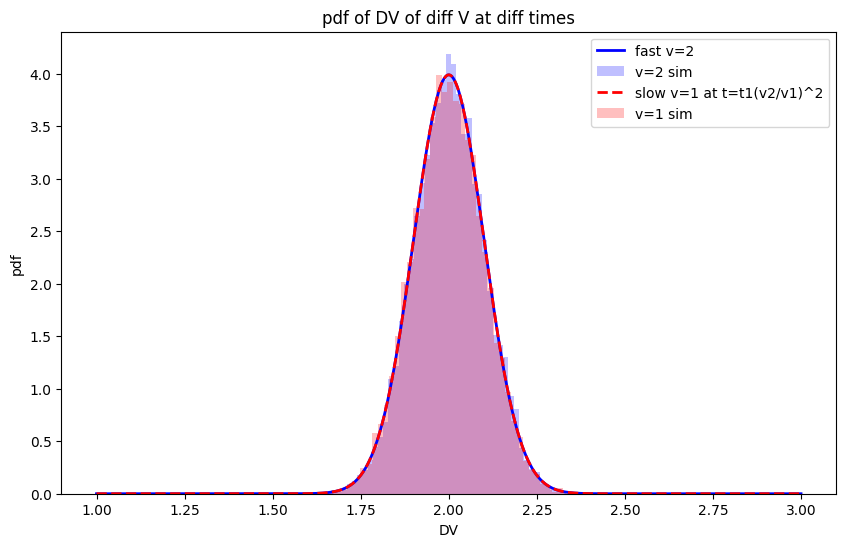

In [120]:
plt.figure(figsize=(10,6))
plt.plot(x_pts, pdf_1, label=f'fast v={v1}', color='b', linestyle='-', linewidth=2)
plt.hist(sim_results_v1[:, t_fast_idx], bins=50, density=True, alpha=0.25, label=f'v={v1} sim', color='b')


t_slow = ((v1/v2))*t_fast
t_slow_idx = int(t_slow/dt)
pdf_2 = [pdf(x, v2, t_slow, sigma_by_mu_2) for x in x_pts]

plt.plot(x_pts, pdf_2, label=f'slow v={v2} at t=t1(v2/v1)^2', color='r', linestyle='--', linewidth=2)
plt.hist(sim_results_v2[:, t_slow_idx], bins=50, density=True, alpha=0.25, label=f'v={v2} sim', color='r')
plt.legend();
plt.xlabel('DV'); plt.ylabel('pdf'); plt.title('pdf of DV of diff V at diff times');

In [13]:
from psiam_utils import P_x_small_t_fn

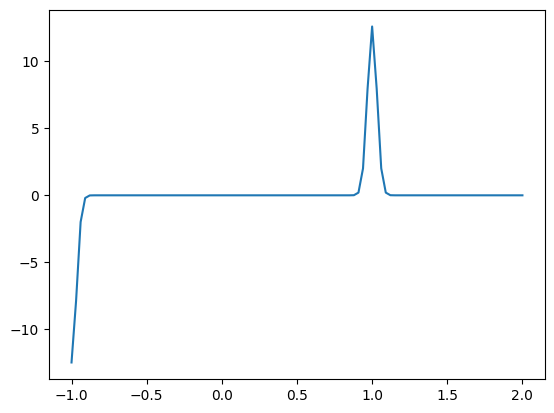

In [53]:
# P_x_small_t_fn(x, t, V_E, theta_E, Z, K_max)
V_E = 0.005; theta_E = 1; Z = 0; K_max = 100; t = 0.001
x_pts = np.linspace(-1, 2, 100)

P_xt = [P_x_small_t_fn(x, t, V_E, theta_E, Z, K_max) for x in x_pts]

plt.plot(x_pts, P_xt);


# animation

In [58]:
T1 = int(2 / dt)
T2 = T1

t_fixed = int(0.1/ dt)

t_start = int(0.05 / dt)
t_end = int(1/ dt)
dt_indices = int(0.001 / dt)  # Step size in indices


Animation size has reached 20995419 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


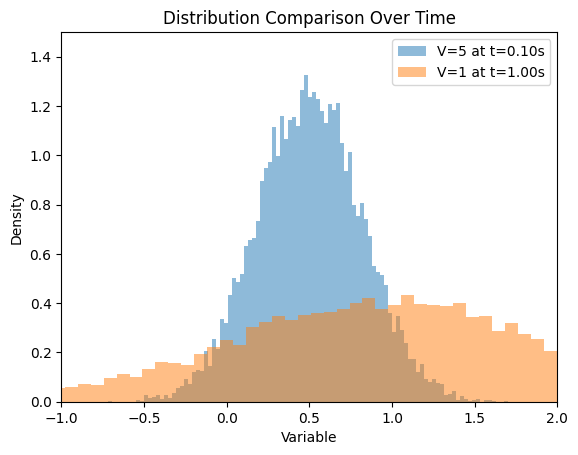

In [61]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

%matplotlib inline

data_v1 = sim_results_v1[:, t_fixed]

time_indices = np.arange(t_start, t_end, dt_indices, dtype=int)
data_v2 = sim_results_v2[:, time_indices]



fig, ax = plt.subplots()

def animate(i):
    ax.clear()
    # Plot histogram of sim_results_v1 at the fixed time
    ax.hist(data_v1, bins=100, alpha=0.5, density=True, label=f'V={v1} at t={t_fixed*dt:.2f}s')

    # Get current time index and remove NaNs from sim_results_v2
    t = time_indices[i]
    data_v2 = sim_results_v2[:, t]
    data_v2 = data_v2[~np.isnan(data_v2)]

    # Plot histogram of sim_results_v2 at current time
    ax.hist(data_v2, bins=100, alpha=0.5, density=True, label=f'V={v2} at t={t*dt:.2f}s')

    ax.legend()
    ax.set_title('Distribution Comparison Over Time')
    ax.set_xlabel('Variable')
    ax.set_ylabel('Density')
    ax.set_xlim(-1, 2)  # Set x-axis limits to -1 to 1.5
    ax.set_ylim(0, 1.5)  # Set x-axis limits to -1 to 1.5

  # Ensure consistent x-axis limits

ani = animation.FuncAnimation(
    fig, animate, frames=len(time_indices), interval=200, repeat=False
)

# Display the animation in the notebook
HTML(ani.to_jshtml())


Animation size has reached 20974599 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


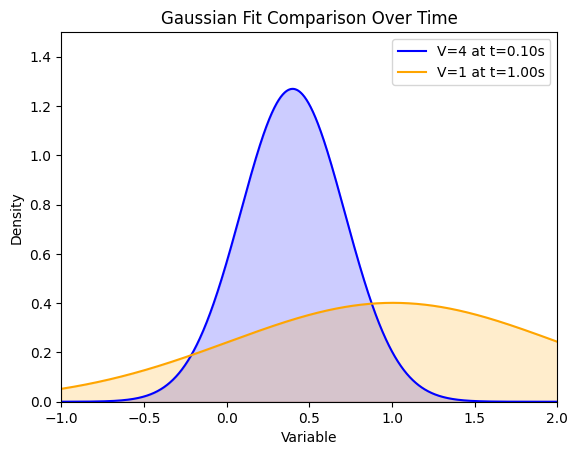

In [12]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

%matplotlib inline


# Time indices for sim_results_v2 from t_start to t_end in steps of 0.01s
time_indices = np.arange(t_start, t_end + dt_indices, dt_indices, dtype=int)

# Remove NaNs from sim_results_v1 at the fixed time
data_v1 = sim_results_v1[:, t_fixed]
data_v1 = data_v1[~np.isnan(data_v1)]

fig, ax = plt.subplots()

def animate(i):
    ax.clear()
    
    # Get current time index and remove NaNs from sim_results_v2
    t = time_indices[i]
    data_v2 = sim_results_v2[:, t]
    data_v2 = data_v2[~np.isnan(data_v2)]
    
    # Calculate mean and std for data_v1 and data_v2
    mean_v1 = np.mean(data_v1)
    std_v1 = np.std(data_v1)
    
    mean_v2 = np.mean(data_v2)
    std_v2 = np.std(data_v2)
    
    # Create x values for plotting
    x = np.linspace(-1, 2, 1000)
    
    # Calculate normal distribution PDFs for both datasets
    pdf_v1 = (1 / (std_v1 * np.sqrt(2 * np.pi))) * np.exp(-0.5 * ((x - mean_v1) / std_v1) ** 2)
    pdf_v2 = (1 / (std_v2 * np.sqrt(2 * np.pi))) * np.exp(-0.5 * ((x - mean_v2) / std_v2) ** 2)
    
    # Plot the normal distribution curves
    ax.plot(x, pdf_v1, label=f'V={v1} at t={t_fixed*dt:.2f}s', color='blue')
    ax.plot(x, pdf_v2, label=f'V={v2} at t={t * dt:.2f}s', color='orange')
    
    # Optional: Fill under the curves for better visualization
    ax.fill_between(x, pdf_v1, color='blue', alpha=0.2)
    ax.fill_between(x, pdf_v2, color='orange', alpha=0.2)
    
    # Set plot limits and labels
    ax.set_xlim(-1, 2)  # Set x-axis limits to -1 to 2
    ax.set_ylim(0, 1.5)  # Set y-axis limits to 0 to 1.5
    ax.set_title('Gaussian Fit Comparison Over Time')
    ax.set_xlabel('Variable')
    ax.set_ylabel('Density')
    ax.legend()

ani = animation.FuncAnimation(
    fig, animate, frames=len(time_indices), interval=200, repeat=False
)

# Display the animation in the notebook
HTML(ani.to_jshtml())
